<a href="https://colab.research.google.com/github/EllieMwangi/Demo-app/blob/master/House_Prices_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Data Exploration

In [ ]:
# Import Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import RobustScaler
from sklearn.model_selection import train_test_split as tts
import statsmodels
from sklearn.linear_model import LinearRegression

%matplotlib inline
sns.set()
plt.rcParams['figure.figsize'] = (12.0, 10.0)

In [ ]:
# Install and load pandas profiler
!pip install pandas-profiling==2.6.0

In [ ]:
from pandas_profiling import ProfileReport

In [ ]:
# Load dataset
house_data = pd.read_csv('house_data.csv')

In [ ]:
#Preview data
house_data.head()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


In [ ]:
# Sample 5 records
house_data.sample(5)

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
2098,2568300132,521000.0,3,2.00,1870,5455,1.0,0,0,5,7,1060,810,1926,0,98125,47.7029,-122.297,1870,7435
14201,6190701484,450000.0,7,3.50,2830,8625,1.0,0,0,4,8,1830,1000,1957,0,98133,47.7493,-122.355,1570,8400
20082,2767704252,478000.0,3,3.25,1430,1348,2.0,0,0,3,8,1160,270,2008,0,98107,47.6743,-122.374,1160,1265
13539,424000145,230000.0,3,1.00,1390,6000,1.0,0,0,3,5,1390,0,1954,0,98056,47.4977,-122.175,1170,6000
1815,3629920140,477000.0,3,2.25,1260,3000,2.0,0,0,3,7,1260,0,2003,0,98029,47.5459,-121.997,1630,3023


In [ ]:
# Check shape of data
house_data.shape

(21613, 20)

In [ ]:
# Describe data
house_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 20 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   price          21613 non-null  float64
 2   bedrooms       21613 non-null  int64  
 3   bathrooms      21613 non-null  float64
 4   sqft_living    21613 non-null  int64  
 5   sqft_lot       21613 non-null  int64  
 6   floors         21613 non-null  float64
 7   waterfront     21613 non-null  int64  
 8   view           21613 non-null  int64  
 9   condition      21613 non-null  int64  
 10  grade          21613 non-null  int64  
 11  sqft_above     21613 non-null  int64  
 12  sqft_basement  21613 non-null  int64  
 13  yr_built       21613 non-null  int64  
 14  yr_renovated   21613 non-null  int64  
 15  zipcode        21613 non-null  int64  
 16  lat            21613 non-null  float64
 17  long           21613 non-null  float64
 18  sqft_l

No null values in data.

In [ ]:
# Check for duplicates
house_data.duplicated().sum()

3

In [ ]:
# Get rid of duplicate records
house_data.drop_duplicates(inplace=True)

### Data Analysis

In [ ]:
# Generate profile report for housing data
data_profile = ProfileReport(house_data.drop('id', axis=1))
data_profile

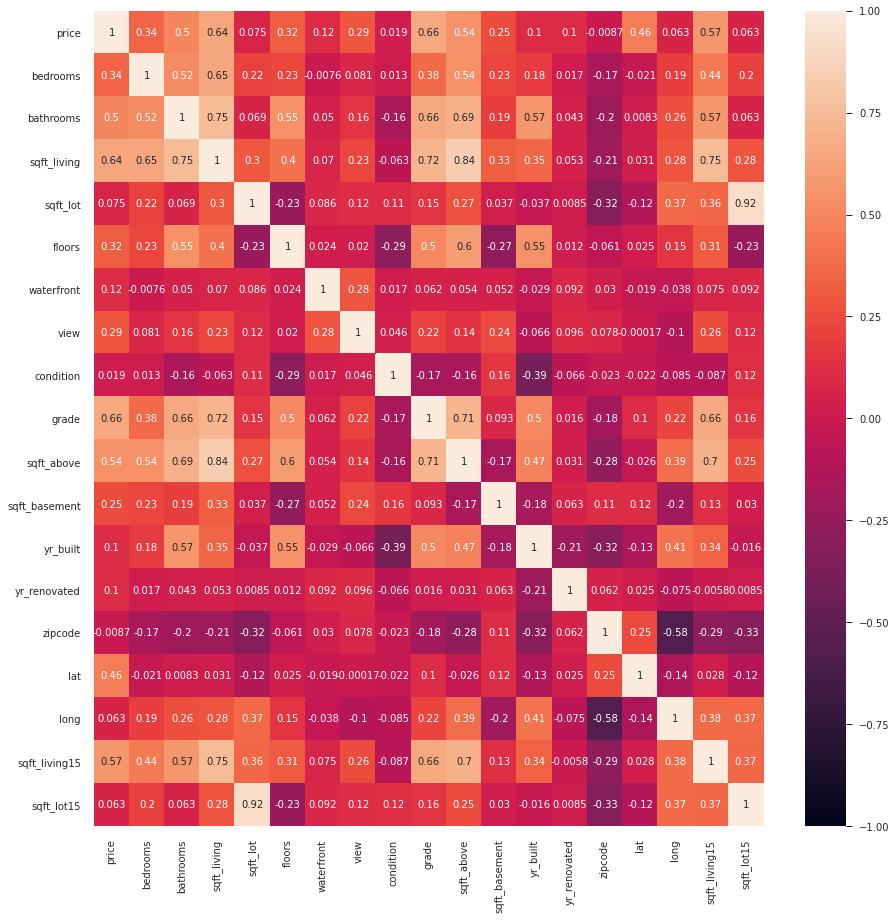

In [ ]:
# plot a correlation matrix
spearman_corr = house_data.drop('id', axis=1).corr(method='spearman')
plt.figure(figsize=(15,15))
sns.heatmap(spearman_corr, vmin=-1, vmax=1, annot=True)

Based on the correlation matrix, the following features have the highest correlation with Price target variable:
- sqft_living
- grade
- sqft_above
- sqft_living15
- bathrooms


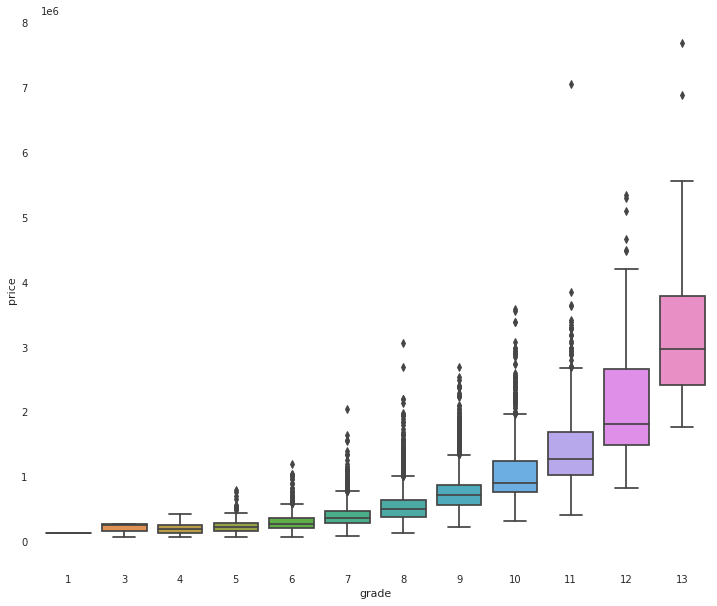

In [ ]:
# Investigate relation between house price and grade
plt.figure(figsize=(12,10))
sns.boxplot(x=house_data['grade'], y=house_data['price'])

Houses of higher grades have higher prices.

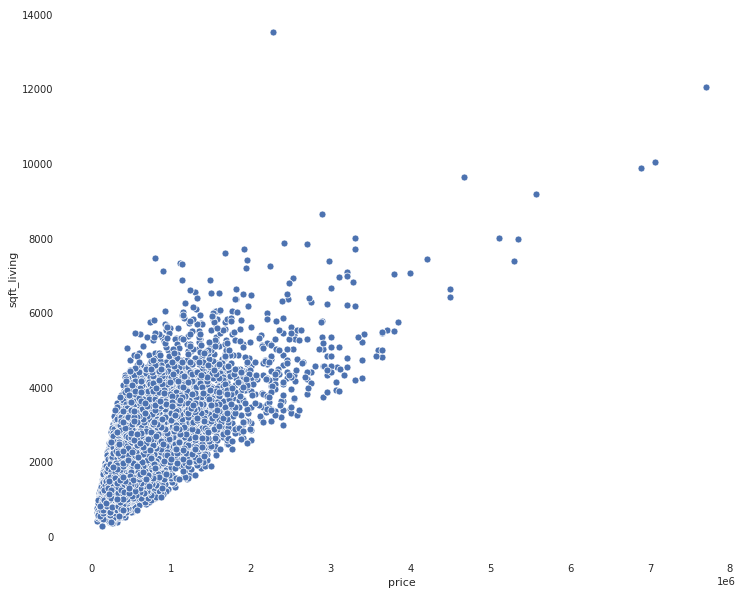

In [ ]:
# Investigate relation between house price and sqft_living
plt.figure(figsize=(12,10))
sns.scatterplot(house_data['price'], house_data['sqft_living'])

Houses with a larger living space tend to have a higher price.

'Correlation: '

0.7564195702606058

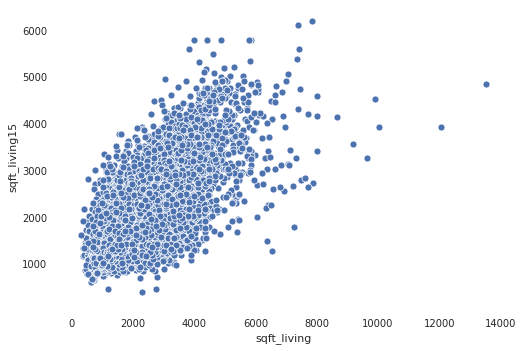

In [ ]:
# Investigate relationship between sqft_living and sqft_living15
display("Correlation: ", house_data['sqft_living'].corr(house_data['sqft_living15']))
sns.scatterplot(house_data['sqft_living'], house_data['sqft_living15'])

High correlation between sqft_living and sqft_living15

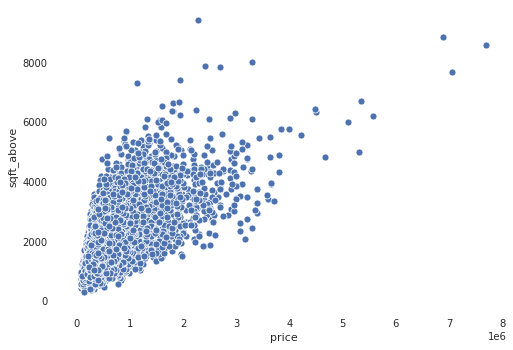

In [ ]:
# Investigate relation between house price and sqft_living
sns.scatterplot(house_data['price'], house_data['sqft_above'])

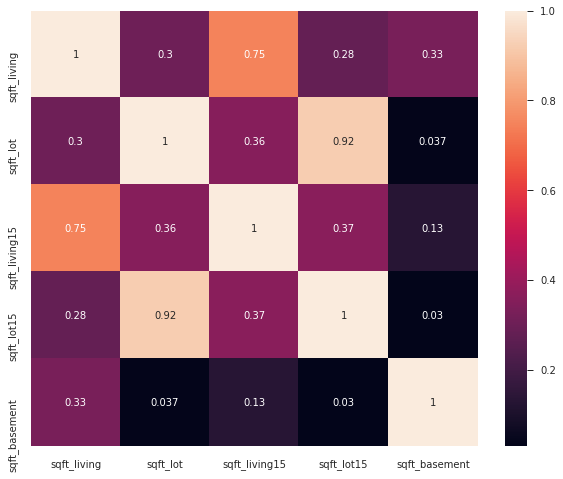

In [ ]:
# Check correlation between square footage features
footage_features = ['sqft_living', 'sqft_lot','sqft_living15', 'sqft_lot15','sqft_basement']
plt.figure(figsize=(10,8))
sns.heatmap(house_data[footage_features].corr(method='spearman'), annot=True)


High correlation between sqft_lot and sqft_lot15 as well as between sqft_living and sqft_living15

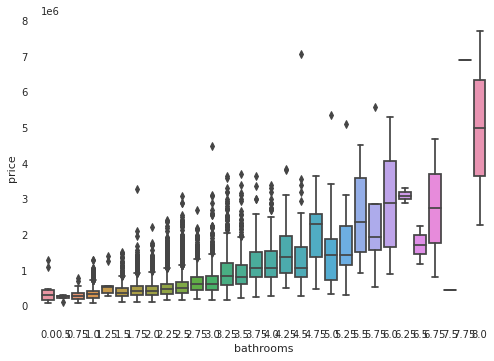

In [ ]:
# Investigate relationship between price and bathrooms
sns.boxplot(x=house_data['bathrooms'], y=house_data['price'])

There is a discernable increase in price as the number of bathrooms increases

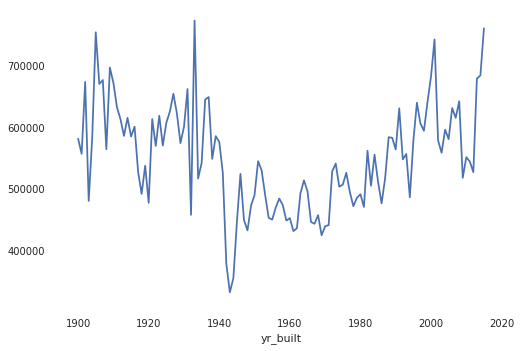

In [ ]:
# Get the average price of houses per year
house_data.groupby('yr_built')['price'].mean().plot()

Houses built between 1940 and 1950 have the lowest average price

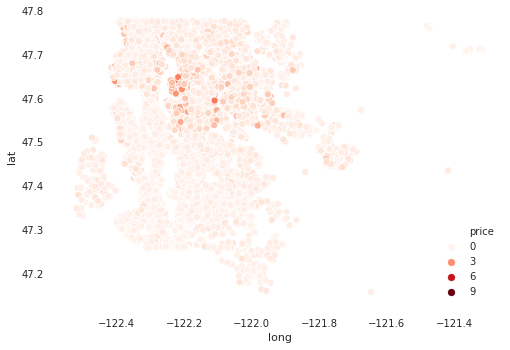

In [ ]:
sns.scatterplot(house_data['long'], house_data['lat'], hue=house_data['price'], palette='Reds')

Through a simple visualization , it is observable that high priced houses seem to be concentrated in the upper region of the map. 

#### Cluster Analysis of Location Data

In [ ]:
from sklearn.cluster import KMeans
location_data = house_data[['long','lat']].to_numpy()

In [ ]:
# Perform kmeans clustering with 7 clusters
kmeans = KMeans(n_clusters=7)
kmeans.fit(location_data)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=7, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

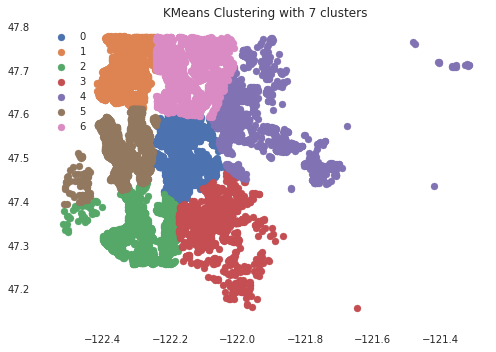

In [ ]:
# Get the kmeans scatter plot
predictions = kmeans.labels_
clusters = np.unique(kmeans.labels_)

for clust in clusters:
  row_ix = np.where(predictions == clust)
  plt.scatter(location_data[row_ix, 0], location_data[row_ix, 1], label=clust)

plt.title('KMeans Clustering with 7 clusters')
plt.legend()
plt.show()

In [ ]:
# Select appropriate number of clusters with elbow method
SSE = []
for k in  __builtin__.range(1, 15):
  kmeans = KMeans(n_clusters=k, random_state=42)
  kmeans.fit(location_data)
  SSE.append(kmeans.inertia_)

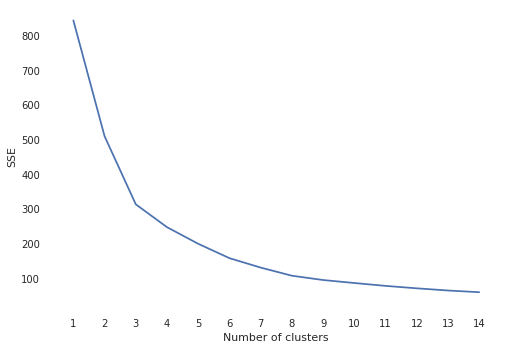

In [ ]:
plt.plot(__builtin__.range(1, 15), SSE)
plt.xticks(__builtin__.range(1,15))
plt.xlabel('Number of clusters')
plt.ylabel('SSE')
plt.show()

In [ ]:
# Determine appropriate number of clusters using Knee locator
!pip install kneed
from kneed import KneeLocator

In [ ]:
appropriate_k = KneeLocator(__builtin__.range(1,15), SSE, curve='convex', direction='decreasing')
appropriate_k.elbow

4

According to the knee locator, the appropriate number of clusters is 4, however 4  clusters will coalesce the region data into 4 big regions that might takeaway some of the nuance of the region specific house pricing.

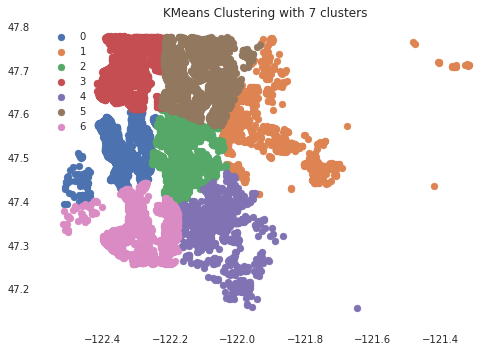

In [ ]:
# Perform kmeans clustering with 7 clusters
kmeans = KMeans(n_clusters=7)
kmeans.fit(location_data)

# Get the kmeans scatter plot
predictions = kmeans.labels_
clusters = np.unique(kmeans.labels_)

for clust in clusters:
  row_ix = np.where(predictions == clust)
  plt.scatter(location_data[row_ix, 0], location_data[row_ix, 1], label=clust)

plt.title('KMeans Clustering with 7 clusters')
plt.legend()
plt.show()

In [ ]:
# Create region column based on the cluster labels
labels = kmeans.labels_
house_data['region'] = labels

In [ ]:
# Get the average house price per region
house_data.groupby('region')['price'].mean().sort_values(ascending=False)

region
5    692364.184962
3    632723.922019
2    579309.170724
1    579159.407887
0    441949.446626
4    346688.222816
6    292079.122784
Name: price, dtype: float64

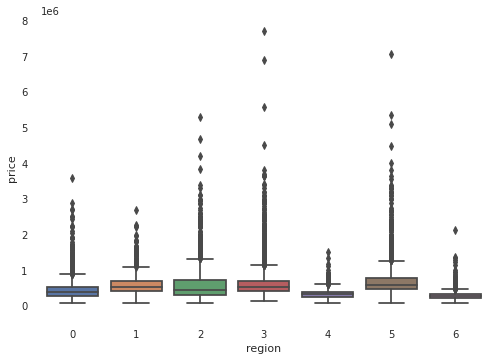

In [ ]:
# Investigate relationship between region and house price
sns.boxplot(house_data['region'], house_data['price'])

Regions 5 and 4, have considerably lower house prices

In [ ]:
# Investigate correlation
house_data[['price','region']].corr(method='spearman')

,price,region
price,1.000000,-0.044489
region,-0.044489,1.000000


Correlation between price and region is -0.21, slightly significant negative correlation.

#### Renovation Feature

In [ ]:
house_data.groupby(['yr_renovated'])['yr_renovated'].count()/house_data.shape[0]

yr_renovated
0       0.957751
1934    0.000046
1940    0.000093
1944    0.000046
1945    0.000139
          ...   
2011    0.000602
2012    0.000509
2013    0.001712
2014    0.004211
2015    0.000740
Name: yr_renovated, Length: 70, dtype: float64

A large percentage of houses (95%) have 0 as their renovation year, taking the assumption that 0 means that the house has not been renovated, a binary feature indicating if a house has been renovated or not, is more suitable

In [ ]:
house_data['renovated'] = np.where(house_data['yr_renovated'] == 0, 0,1)

In [ ]:
house_data.groupby('renovated')['price'].mean()

renovated
0    530444.136590
1    760859.477547
Name: price, dtype: float64

Renovated houses have a higher average price despite being considerably fewer than houses that have not been renovated.

In [ ]:
# bin year built variable
bins = [1900, 1905, 1910, 1915, 1920, 1925, 1930, 1935, 1940, 1945, 1950, 1955, 1960, 1965, 1970, 1975, 1980, 1985, 1990, 1995, 2000, 2005, 2010, 2015]
house_data['yr_built_binned'] = np.searchsorted(bins, house_data['yr_built'].values)
house_data[['yr_built', 'yr_built_binned']].head(10)

,yr_built,yr_built_binned
0,1955,11
1,1951,11
2,1933,7
3,1965,13
4,1987,18
5,2001,21
6,1995,19
7,1963,13
8,1960,12
9,2003,21


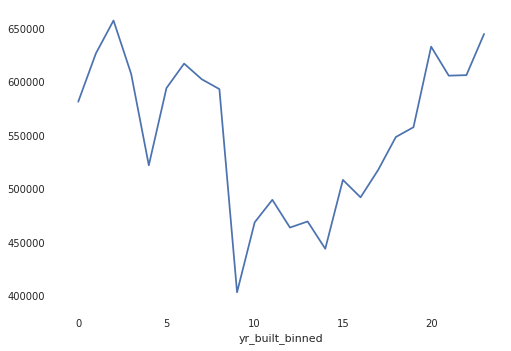

In [ ]:
house_data.groupby(['yr_built_binned'])['price'].mean().plot()

In [ ]:
house_data[['yr_built_binned','price']].corr(method='spearman')

,yr_built_binned,price
yr_built_binned,1.000000,0.103307
price,0.103307,1.000000


Minimal correlation between year built and the price variable.

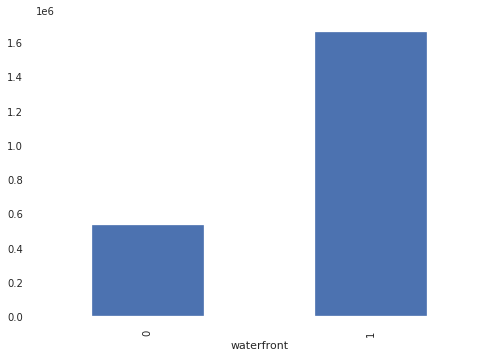

In [ ]:
house_data.groupby('waterfront')['price'].mean().plot(kind='bar')

Houses with overlooking a waterfront have a higher average price

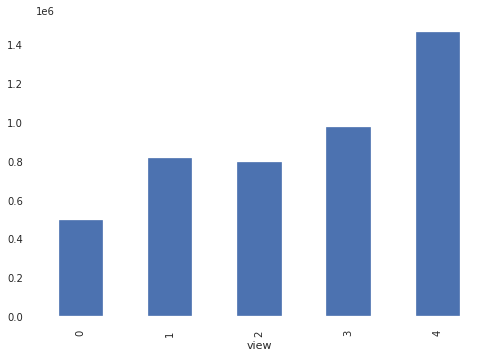

In [ ]:
house_data.groupby('view')['price'].mean().plot(kind='bar')

Average house price increases as the view index also increases.

In [ ]:
house_data.groupby(['condition'])['price'].mean().sort_values(ascending=False)

condition
5    612577.742504
3    542093.108133
4    521295.650757
1    334431.666667
2    327316.215116
Name: price, dtype: float64

Houses with the highest condition index 5 have the highest average price.

In [ ]:
'''
The sqft_living feature is sum of sqft_above and sqft_basement for all records. 
This means that sqft_above and sqft_basement are doing the same thing as sqft_living 
Elastic Net Regression/Lasso regression would set one to zero.
'''
(house_data['sqft_above'] + house_data['sqft_basement'] == house_data['sqft_living']).value_counts()

True    21610
dtype: int64

4.021467451317612

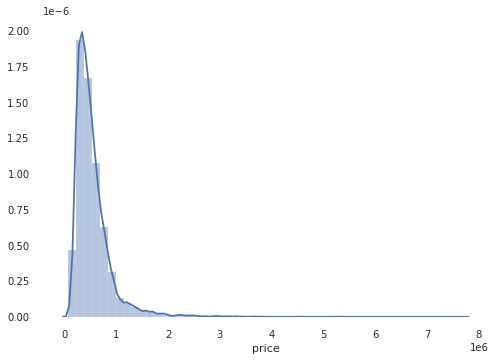

In [ ]:
# Investigate target variable
sns.distplot(house_data['price'])
house_data['price'].skew()

The price variable is heavily skewed to the right, with a skew of 4.02

In [ ]:
# Create modelling dataset with useful features
to_drop = ['id', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long']
model_data = house_data.drop(to_drop, axis=1)

#### Test for Multicollinearity

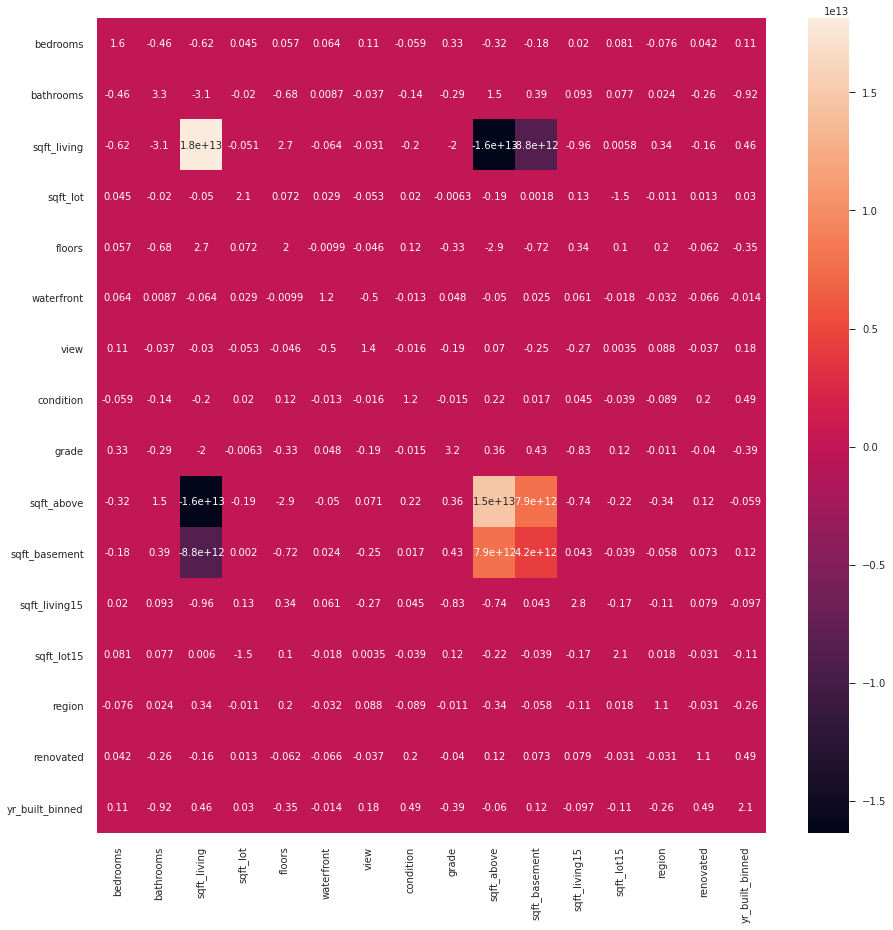

In [ ]:
# Check the variance inflation factor
corr_matrix = model_data.drop('price', axis=1).corr()
vif = pd.DataFrame(np.linalg.inv(corr_matrix), index=corr_matrix.index, columns=corr_matrix.columns)
plt.figure(figsize=(15,15))
sns.heatmap(vif, annot=True)

As expected, sqft_living, sqft_above and sqft_basement have extremely high variance factors, to mitigate this, drop the sqft_above and sqft_basement features.

In [ ]:
model_data.drop(['sqft_above','sqft_basement'], axis=1, inplace=True)

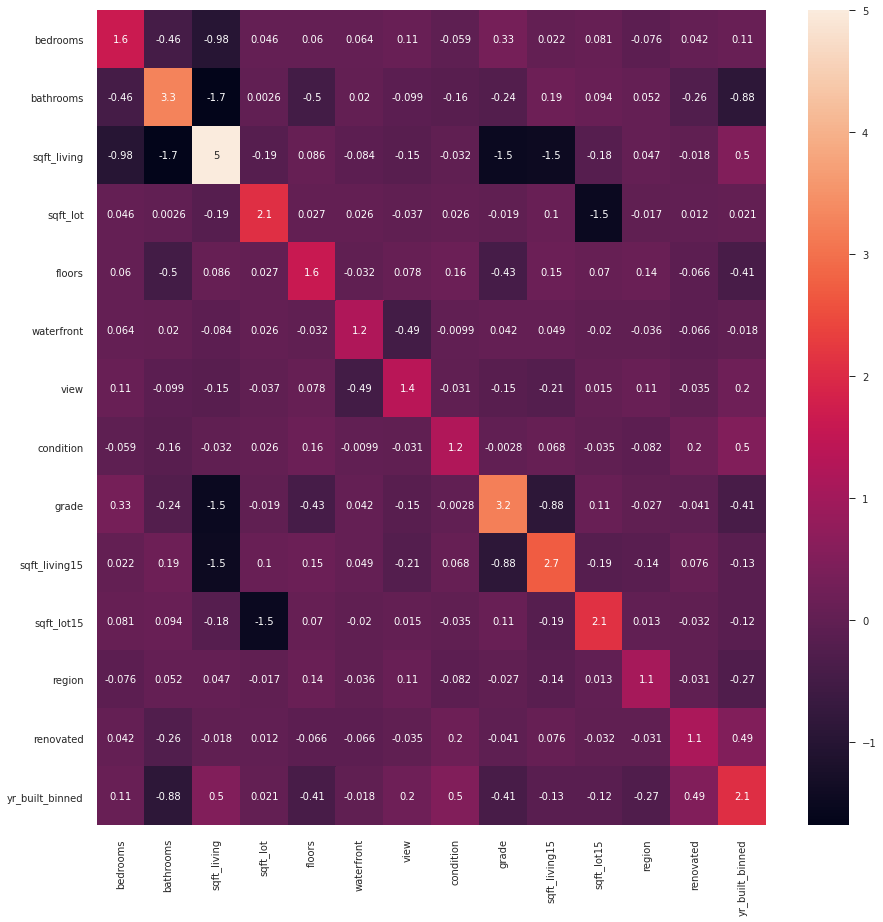

In [ ]:
# Check the variance inflation factor
corr_matrix = model_data.drop('price', axis=1).corr()
vif = pd.DataFrame(np.linalg.inv(corr_matrix), index=corr_matrix.index, columns=corr_matrix.columns)
plt.figure(figsize=(15,15))
sns.heatmap(vif, annot=True)

### Multiple Linear Regression

In [ ]:
from sklearn.metrics import mean_squared_error
from scipy.stats import bartlett, chi2

In [ ]:
model_data.head()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_living15,sqft_lot15,region,renovated,yr_built_binned
0,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1340,5650,0,0,11
1,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,1690,7639,3,1,11
2,180000.0,2,1.00,770,10000,1.0,0,0,3,6,2720,8062,3,0,7
3,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1360,5000,0,0,13
4,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1800,7503,5,0,18


In [ ]:
dummy_var = ['waterfront','view','renovated']
X = model_data.drop('price', axis=1)
Y = model_data['price']

# Split data
x_train, x_test, y_train, y_test = tts(X, Y, test_size=.3, random_state=24)

In [ ]:
#Scale features
scaler = RobustScaler().fit(x_train.drop(dummy_var, axis=1))
num_train = scaler.transform(x_train.drop(dummy_var, axis=1))
x_train = np.concatenate((num_train, x_train[dummy_var].to_numpy()), axis=1)

num_test = scaler.transform(x_test.drop(dummy_var, axis=1))
x_test = np.concatenate((num_test, x_test[dummy_var].to_numpy()), axis=1)

In [ ]:
#Linear regression

linreg = LinearRegression()
linreg.fit(x_train, y_train)
linpred = linreg.predict(x_test)

residuals = np.subtract(linpred, y_test)
print('RMSE: ', np.sqrt(mean_squared_error(y_test,linpred)))

RMSE:  214177.15968237945


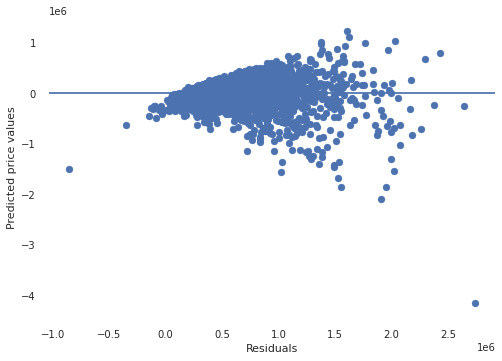

In [ ]:
# Create residual plot
plt.scatter(linpred, residuals)
plt.xlabel('Residuals')
plt.ylabel('Predicted price values')
plt.axhline(residuals.mean())

Residuals take on a cone-like shape, variance increasing for greater values of y

In [ ]:
# Perform a bartlett test of variance 
test_result, p_value = bartlett(linpred, residuals)

# Compute a critical value of the chi squared distribution
degree_of_freedom = len(linpred)-1
probability = 1 - p_value

critical_value = chi2.ppf(probability, degree_of_freedom)
print(critical_value, test_result, p_value)

if (test_result > critical_value):
  print('the variances are unequal, and the model should be reassessed')
else:
  print('the variances are homogeneous!')

inf 693.4683804560617 7.871494638257499e-153
the variances are homogeneous!


In [ ]:
import statsmodels.formula.api as sm